In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

# Try to generator some pictures using Hugging Face diffusers

- https://github.com/huggingface/notebooks/blob/main/diffusers/diffusers_intro.ipynb


In [ ]:
import picture_generator

In [ ]:
picture_generator.__version__

In [3]:
import torch
from torch import cuda

In [4]:
torch.cuda.is_available()

True

In [5]:
# later CUDA devices, matrix multiplications and convolutions can use the TensorFloat-32 (TF32) mode for faster, but slightly less accurate computations.
torch.backends.cuda.matmul.allow_tf32 = True

In [6]:
from diffusers import DDPMPipeline, StableDiffusionPipeline

In [7]:
from diffusers import DiffusionPipeline

##

In [ ]:
image_pipe = DDPMPipeline.from_pretrained("google/ddpm-celebahq-256")

In [ ]:
image_pipe.to("cuda")

In [ ]:
help(image_pipe)

In [ ]:
images = image_pipe().images

In [ ]:
images[0]

In [ ]:
##

In [ ]:
# pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16)

In [ ]:
pipe = pipe.to("cuda")

In [ ]:
prompt = "korean girl skiing"

In [ ]:
image = pipe(prompt).images[0]  # image here is in [PIL format](https://pillow.readthedocs.io/en/stable/)

In [ ]:
image

## 

In [ ]:
pipeline = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0")
pipeline.load_lora_weights("ProomptEngineer/pe-pencil-drawing-style")

In [7]:
prompt = "korean girl skiing"
#pipe = pipeline.to("cuda")
images = pipeline(prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

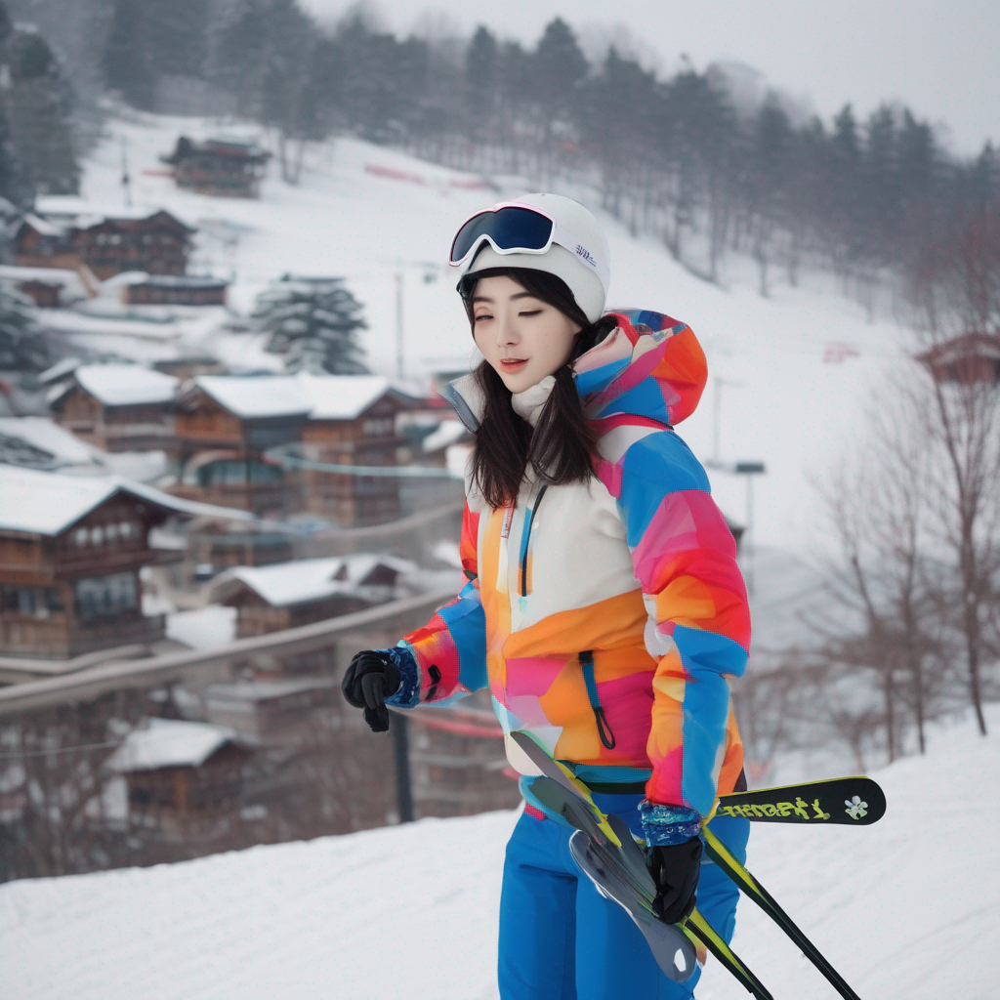

In [9]:
images[0][0]

In [12]:
boys_prompt = "painting, 4boys, cheering, redbulls in hands "
boys_negative_prompt = "disfigured, ugly, bad, immature, photo, amateur, overexposed, underexposed"

boys = pipeline(prompt=boys_prompt, negative_prompt=boys_negative_prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

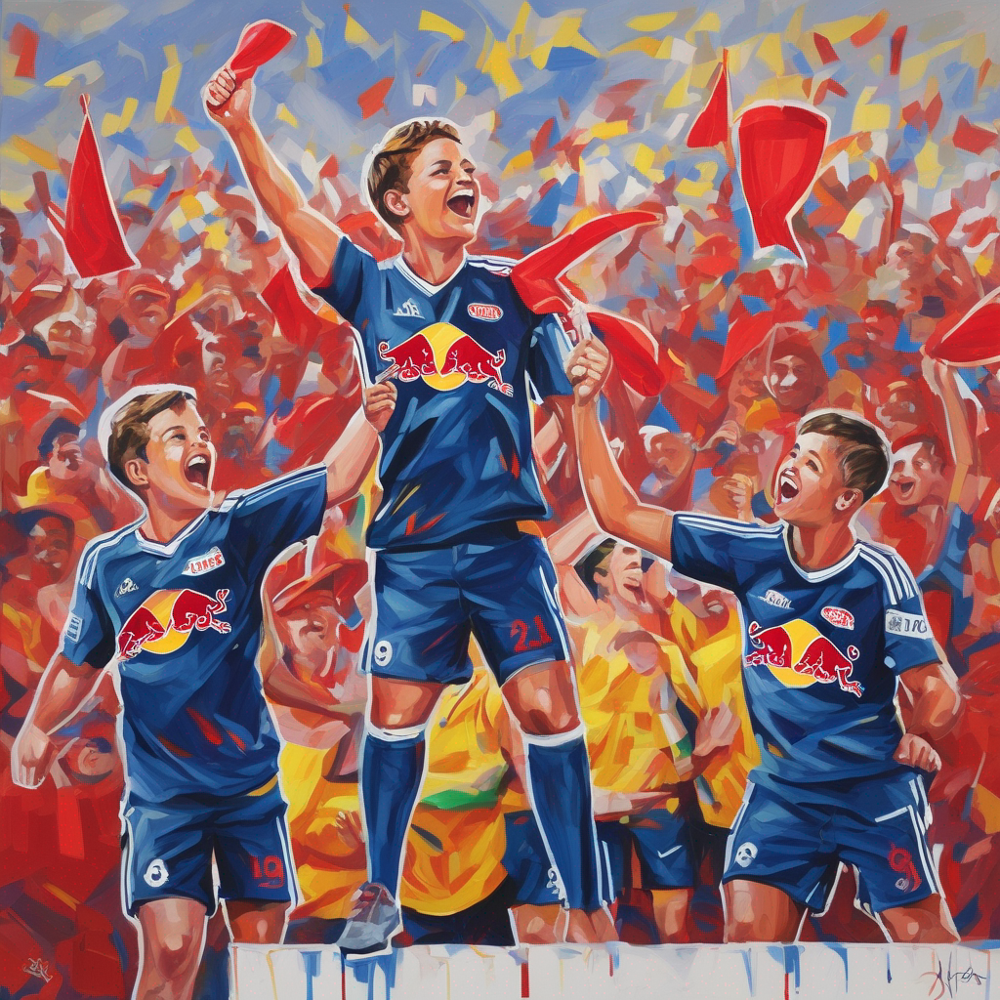

In [13]:
boys[0][0]

In [14]:
pipeline_cuda = pipeline.to("cuda")

In [ ]:
boys_prompt = "pencil, 4 boys, cheering, redbulls in hands "
boys_negative_prompt = "disfigured, ugly, bad, immature, photo, amateur, overexposed, underexposed"

boys_cuda = pipeline_cuda(prompt=boys_prompt, negative_prompt=boys_negative_prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

- https://medium.com/stablediffusion/100-negative-prompts-everyone-are-using-c71d0ba33980

In [18]:
standard_negative = "worst quality, normal quality, low quality, low res, blurry, text, watermark, logo, banner, extra digits, cropped, jpeg artifacts, signature, username, error, sketch ,duplicate, ugly, monochrome, horror, geometry, mutation, disgusting".split(', ')

In [19]:
negative_extended = "bad anatomy, bad hands, three hands, three legs, bad arms, missing legs, missing arms, poorly drawn face, bad face, fused face, cloned face, worst face, three crus, extra crus, fused crus, worst feet, three feet, fused feet, fused thigh, three thigh, fused thigh, extra thigh, worst thigh, missing fingers, extra fingers, ugly fingers, long fingers, horn, realistic photo, extra eyes, huge eyes, 2girl, amputation, disconnected limbs".split(", ")

In [32]:
standard_negative

['worst quality',
 'normal quality',
 'low quality',
 'low res',
 'blurry',
 'text',
 'watermark',
 'logo',
 'banner',
 'extra digits',
 'cropped',
 'jpeg artifacts',
 'signature',
 'username',
 'error',
 'sketch ,duplicate',
 'ugly',
 'monochrome',
 'horror',
 'geometry',
 'mutation',
 'disgusting']

In [25]:
boys_prompt = "pencil style, high contrast, 4 guys, drinking redbull cans, depressed"
boys_negative_prompt = "disfigured, ugly, bad, immature, photo, amateur, overexposed, underexposed, football"

##

In [8]:
pipeline16 = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")

Fetching 27 files:   0%|          | 0/27 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

The config attributes {'add_watermarker': None} were passed to StableDiffusionXLPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'add_watermarker': None} are not expected by StableDiffusionXLPipeline and will be ignored.
The config attributes {'force_upcast': True} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


In [10]:
pipeline16_cuda = pipeline16.to("cuda")

In [15]:
images_boys_16_cuda = pipeline16_cuda(prompt=boys_prompt, negative_prompt=boys_negative_prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

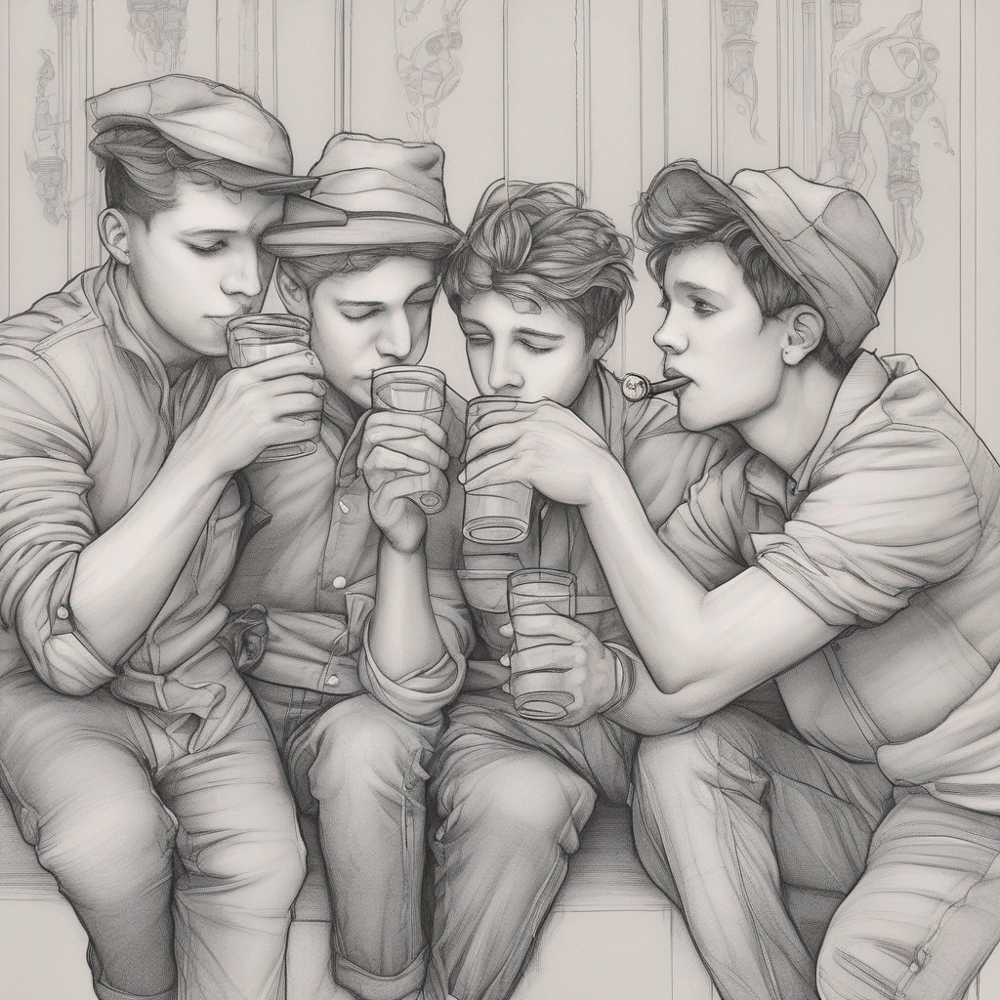

In [18]:
images_boys_16_cuda.images[0]

In [26]:
boys16 = pipeline16(prompt=boys_prompt, negative_prompt=boys_negative_prompt, width=960, height=680, )

  0%|          | 0/50 [00:00<?, ?it/s]

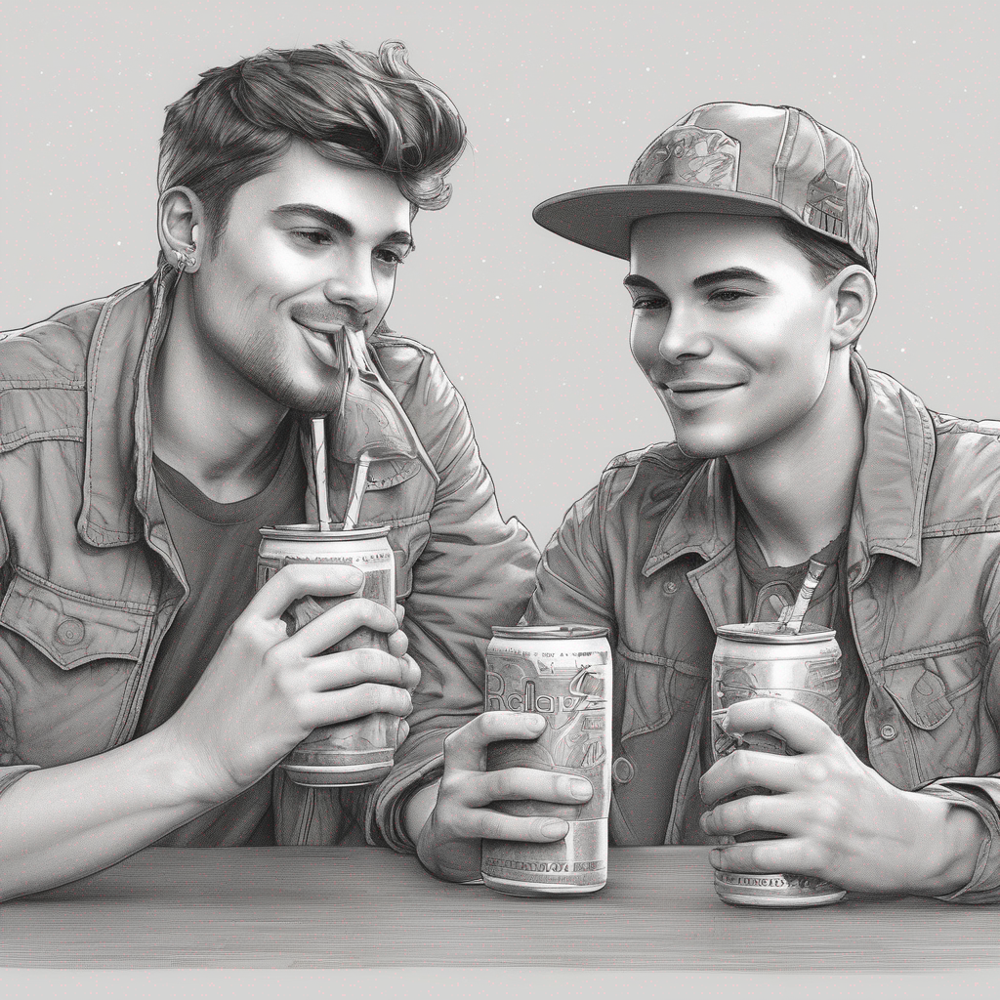

In [21]:
boys16.images[0]

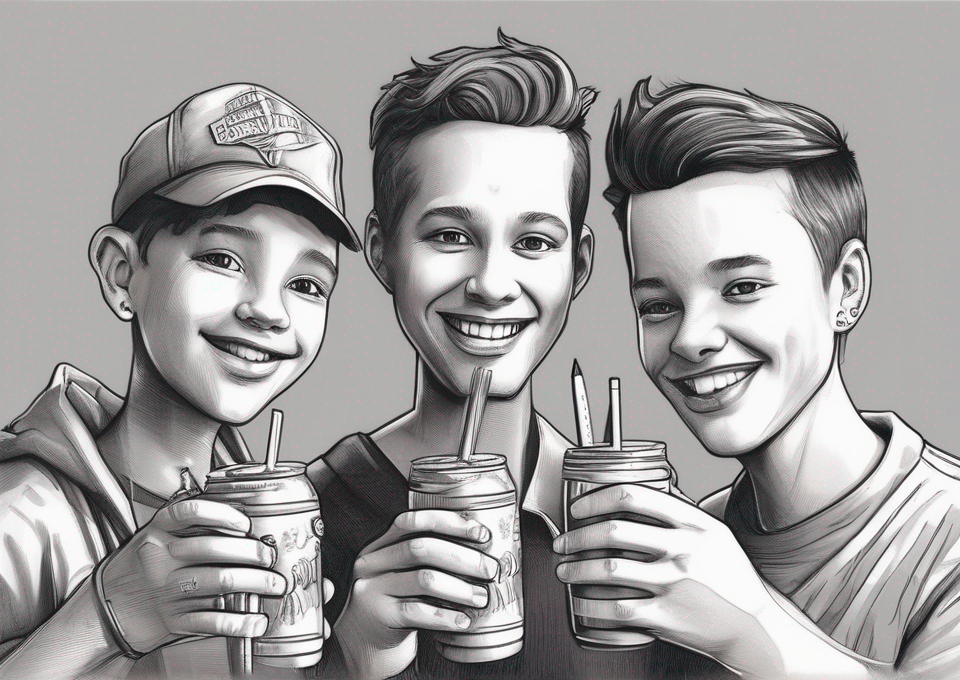

In [24]:
boys16.images[0]

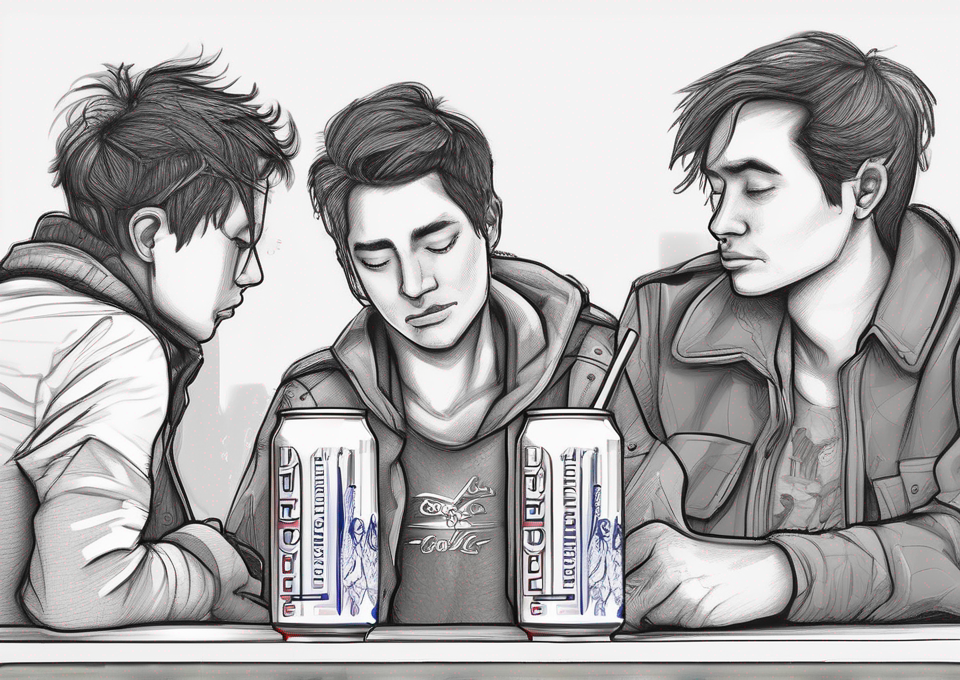

In [27]:
boys16.images[0]

In [37]:
example = pipeline16(prompt="goatse, safe-for-work, pencil drawing", negative_prompt=", ".join(standard_negative), width=960, height=680, )

  0%|          | 0/50 [00:00<?, ?it/s]

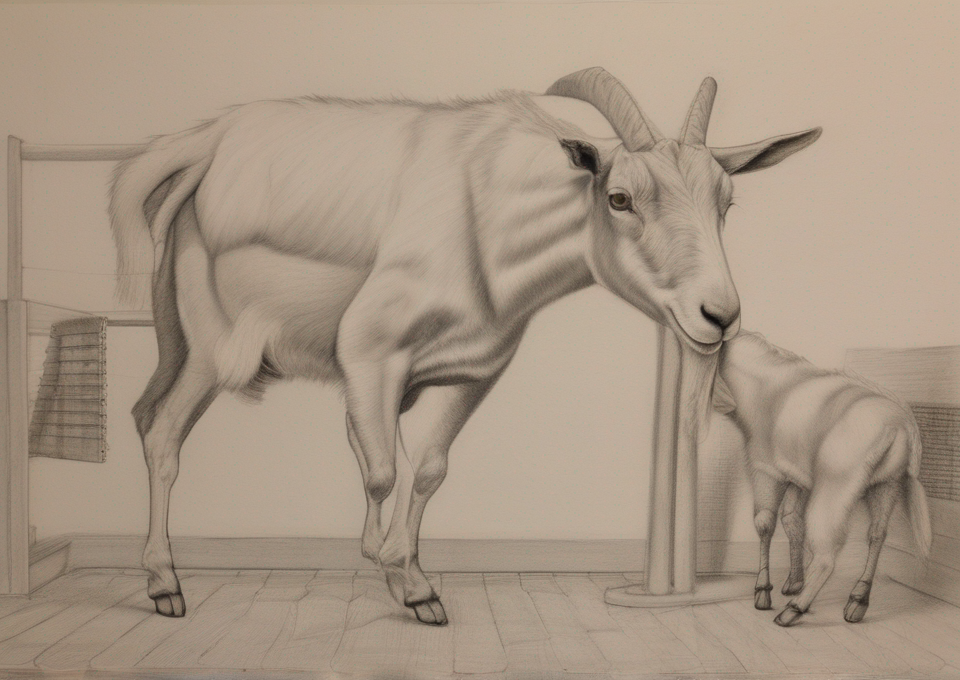

In [38]:
example.images[0]

In [43]:
example1 = pipeline16_cuda(prompt="pencil style, korean girl, skiing, climbing, hiking", negative_prompt=", ".join(standard_negative), width=960, height=680, )

  0%|          | 0/50 [00:00<?, ?it/s]

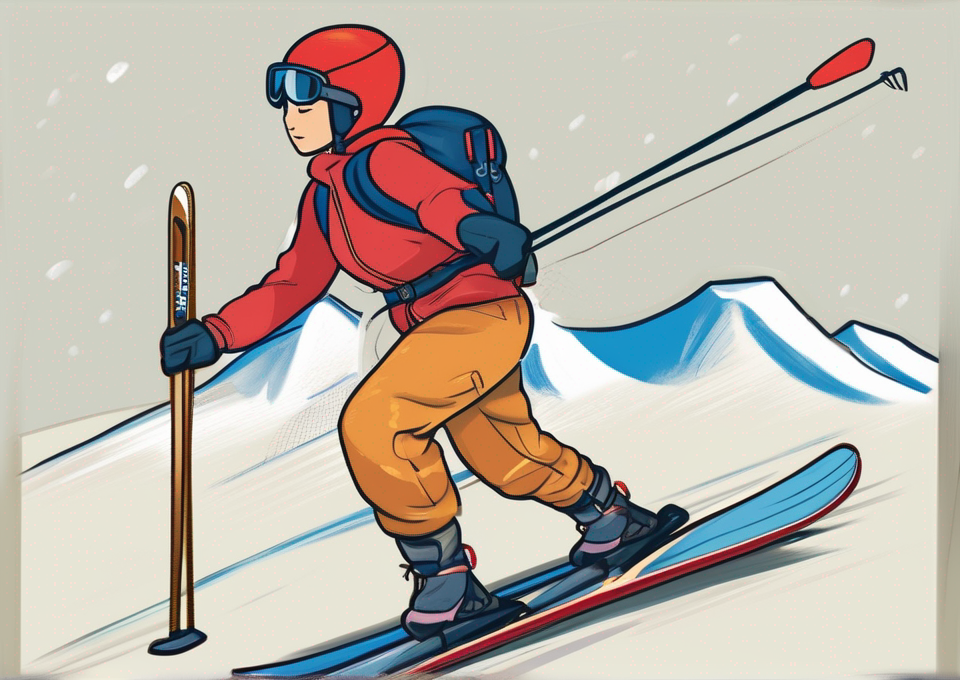

In [44]:
example1.images[0]

In [8]:
# options
options = dict(width=960, height=680,)

In [9]:
device = 'cuda' if cuda.is_available() else 'cpu'
cuda.empty_cache()
print(device)

cuda


In [10]:
torch.cuda.is_available()

True

In [11]:
torch.cuda.ipc_collect()

In [12]:
torch.cuda.device_count()

1

In [13]:
current_device = torch.cuda.current_device()

In [14]:
torch.cuda.device(current_device)

In [15]:
torch.cuda.get_device_name(current_device)

'NVIDIA GeForce GTX 1080'

In [16]:
art_generator = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True, variant="fp16"
)
art_generator = art_generator.to("cuda")

The config attributes {'add_watermarker': None} were passed to StableDiffusionXLPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'add_watermarker': None} are not expected by StableDiffusionXLPipeline and will be ignored.
The config attributes {'force_upcast': True} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


In [32]:
prediction = art_generator(prompt="pencil drawing, korean girl, multisport, skiing, climbing, hiking", negative_prompt="frame, colour, pencils,"+", ".join(standard_negative), **options)

  0%|          | 0/50 [00:00<?, ?it/s]

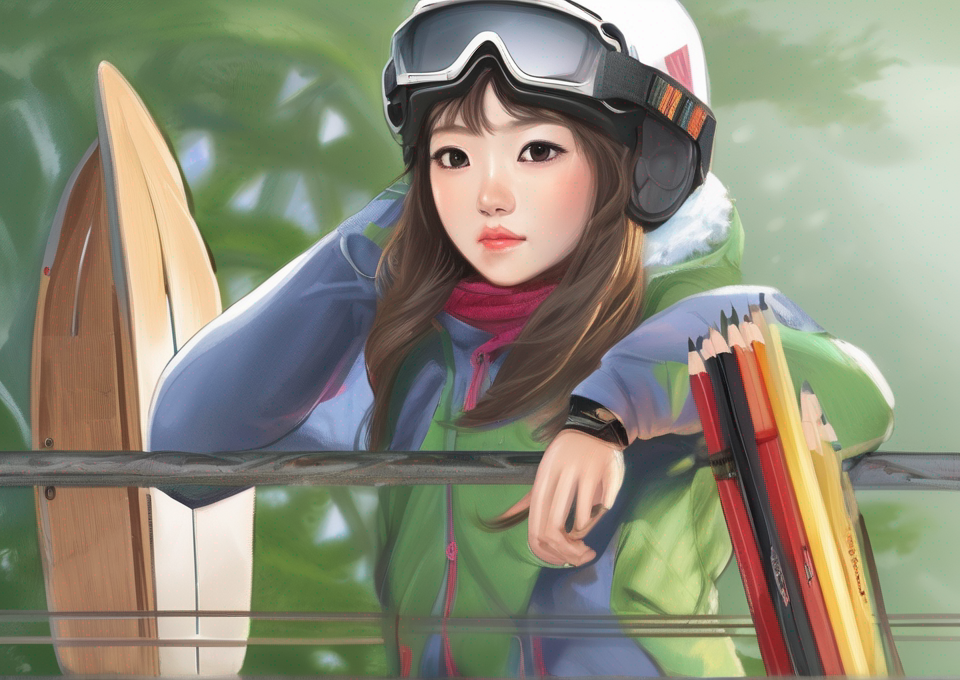

In [21]:
prediction.images[0]

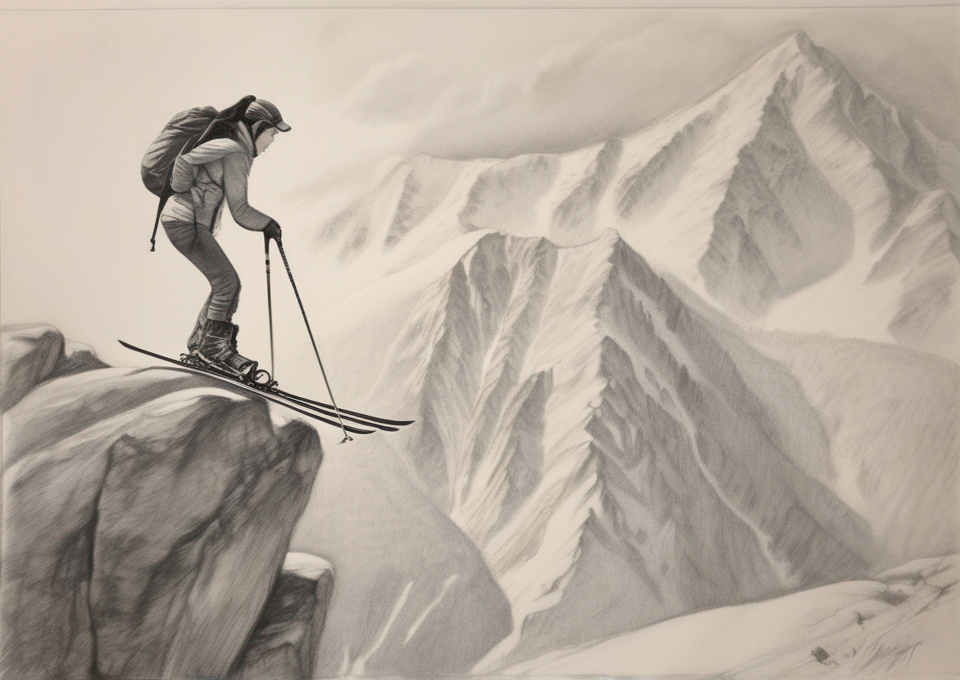

In [29]:
prediction.images[0]

In [28]:
prediction.images[0].save("mountain_girl.bmp")

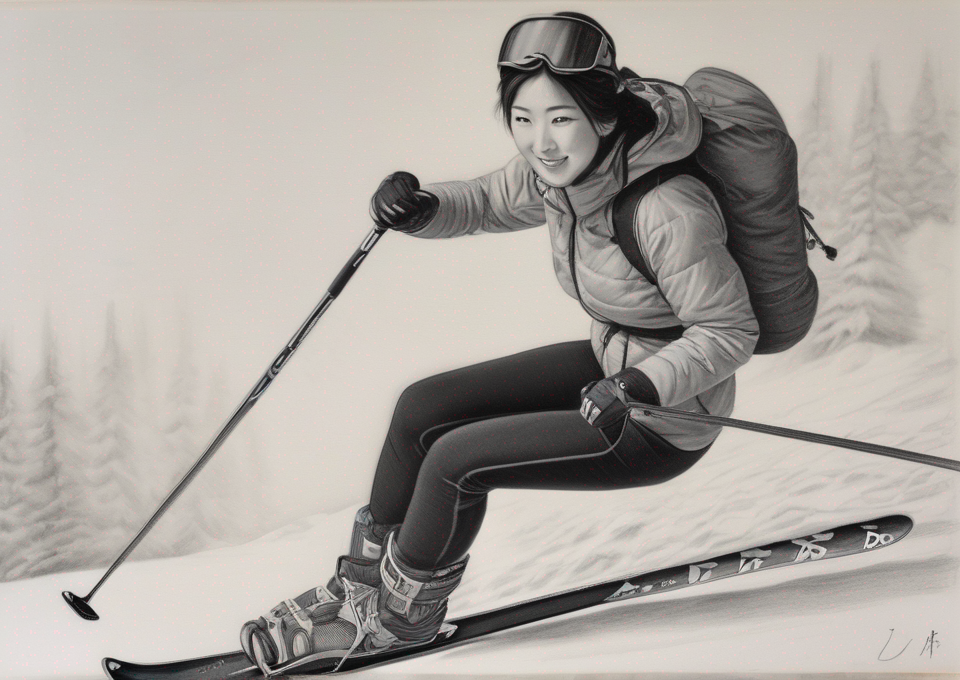

In [31]:
prediction.images[0]

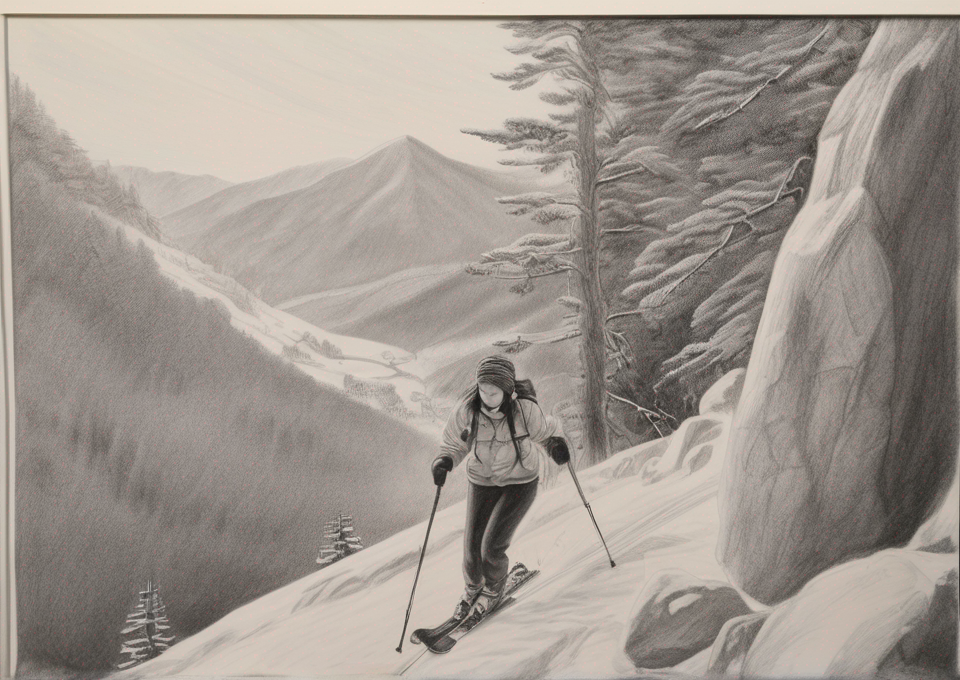

In [33]:
prediction.images[0]